# Housekeeping

In [ ]:
from google.colab import drive
drive.mount('/content/drive', timeout_ms=600000, force_remount=True)

Mounted at /content/drive


Print instance stats.

In [ ]:
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize

  Created wheel for gputil: filename=GPUtil-1.4.0-cp36-none-any.whl size=7413 sha256=ff8dfb2529b6595a44c0e45fea798fc3275c45a636c5e082591c77110ef840d1
  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built gputil


In [ ]:
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()

gpu = GPUs[0]
def printm():
    process = psutil.Process(os.getpid())
    print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
    print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm()

Gen RAM Free: 26.3 GB  | Proc size: 159.9 MB
GPU RAM Free: 16280MB | Used: 0MB | Util   0% | Total 16280MB


First, install and import everything we need to use to implement and visualise the network.

In [ ]:
#!wget https://archive.org/download/documerica/documerica.tar.gz

In [ ]:
#!wget https://archive.org/download/documerica/dustified_64.tar.gz

In [ ]:
#!mkdir /home/jupyter/documerica/

In [ ]:
#!tar -xvzf documerica.tar.gz -C '/home/jupyter/documerica/'

In [ ]:
#!tar -xvzf dustified_64.tar.gz -C '/home/jupyter/documerica/'

In [ ]:
!pip install wandb

     |████████████████████████████████| 1.4MB 2.8MB/s 
     |████████████████████████████████| 460kB 47.9MB/s 
     |████████████████████████████████| 102kB 11.3MB/s 
     |████████████████████████████████| 112kB 30.6MB/s 
     |████████████████████████████████| 102kB 11.6MB/s 
     |████████████████████████████████| 71kB 8.7MB/s 
     |████████████████████████████████| 71kB 8.6MB/s 
  Created wheel for gql: filename=gql-0.2.0-cp36-none-any.whl size=7630 sha256=088089a27c91ff7a6b352d227847712e3e1f0ea1d4c4301646d7269a400e121e
  Stored in directory: /root/.cache/pip/wheels/ce/0e/7b/58a8a5268655b3ad74feef5aa97946f0addafb3cbb6bd2da23
  Created wheel for watchdog: filename=watchdog-0.10.2-cp36-none-any.whl size=73605 sha256=4bcf73043b21b477d6bf35f535d04384412b0f4514b010f9cf7455c0e4befa60
  Stored in directory: /root/.cache/pip/wheels/bc/ed/6c/028dea90d31b359cd2a7c8b0da4db80e41d24a59614154072e
  Created wheel for subprocess32: filename=subprocess32-3.5.4-cp36-none-any.whl size=6489 sha256=fc

In [ ]:
!git clone https://github.com/Po-Hsun-Su/pytorch-ssim.git

Cloning into 'pytorch-ssim'...
remote: Enumerating objects: 60, done.
remote: Total 60 (delta 0), reused 0 (delta 0), pack-reused 60
Unpacking objects: 100% (60/60), done.


In [ ]:
import fastai
import wandb
from wandb.fastai import WandbCallback
from fastai.vision import *
from fastai.callbacks import *
from fastai.callbacks.hooks import *
from fastai.vision.gan import *
from functools import partial
import matplotlib.pyplot as plt
from skimage import io, color, exposure
import numpy as np
import scipy.ndimage
import cv2
from matplotlib import cm
from torchvision.models import vgg16_bn
from fastai.vision.learner import cnn_config
import pytorch_ssim

%matplotlib inline

In [ ]:
torch.manual_seed(420)
torch.cuda.manual_seed_all(420)
np.random.seed(420)
dtype = torch.float

Make sure we use the GPU provided by Colab.

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

We can add a `project_id` and an `experiment_id` to use when logging results.

In [ ]:
project_id = 'FeatLoss+SSIM'
experiment_id = project_id+'-1'

In [ ]:
pwd

'/content'

# Preparing the dataset
The dataset used in this was created by scraping slide scans from Flickr which had no copyright restrictions imposed on them. The photos are part od the Documerica series. I've downsized them, then cropped non-overlappng 512 by 512 squares. The corrupted examples have been created by synthetically adding dust and scratches using free film overlays I found online.

Create the path variables we are going to be using to load the dataset and record model progress on Google Drive. Since we will be progressively resizing the input, we're going to use three different versions of the `dustified` and `clean` classes - images which are 64px, 128px, 256px and 512px squares. Each different size of the same image will have the same file name so we can match them with the clean class. Each of them has different pseudorandom synthetic film noise applied.

In [ ]:
path = '/content/drive/My Drive/documerica'
path_hr = path+'/dataset/clean'
path_hr_256 = path+'/dataset/clean_256'
path_hr_128 = path+'/dataset/clean_128'
path_hr_64 = path+'/dataset/clean_64'
path_lr = path+'/dataset/dustified_512'
path_lr_256 = path+'/dataset/dustified_256'
path_lr_128 = path+'/dataset/dustified_128'
path_lr_64 = path+'/dataset/dustified_64'

In [ ]:
il = ImageList.from_folder(path_hr)
il

ImageList (6232 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /content/drive/My Drive/documerica/dataset/clean

In [ ]:
# def resize_one(fn, i, path, size):
#     dest = path/fn.relative_to(path_hr)
#     dest.parent.mkdir(parents=True, exist_ok=True)
#     img = PIL.Image.open(fn)
#     targ_sz = resize_to(img, size, use_min=True)
#     img = img.resize(targ_sz, resample=PIL.Image.ANTIALIAS).convert('RGB')
#     img.save(dest, quality=100)

# # create smaller image sets the first time this nb is run
# sets = [(path_hr_256, 256), (path_hr_128, 128), (path_hr_64, 64)]
# for p,size in sets:
#     if not os.path.exists(p):
#         print(f"resizing to {size} into {p}")
#         parallel(partial(resize_one, path=p, size=size), il.items)

First we use the standard fast.ai transforms, including 

*   Random crop (w/ padding)
*   Symmetric warp
*   Random rotation
*   Zoom
*   Brightness variation
*   Contrast variation



In [ ]:
tfms_gen = get_transforms(max_zoom=1.5, max_lighting=0.5, max_warp=0.25)
tfms_gen

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmPixel (flip_lr), kwargs={}, p=0.5, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmCoord (symmetric_warp), kwargs={'magnitude': (-0.25, 0.25)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (zoom), kwargs={'scale': (1.0, 1.5), 'row_pct': (0, 1), 'col_pct': (0, 1)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.25, 0.75)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.5, 2.0)}, p=0.75, resolved={},

We create a `DataBunch` using the dustified images. It wraps an `ImageImageList` maps corresponding image pairs from each of the two classes (clean and dusty). In order to split the dataset into training/validation/test using 80/10/10 ratio, we will randomly split the indeces of a dataframe where each index corresponds to an image pair filename. 

First step is to collect image filenames in a dataframe. Filename for the each clean and dusty example from a given pair is the same (they are just in a different subfolder, `clean` or `dustified`.

In [ ]:
data_images = []
for file in sorted(os.listdir(path_hr)):
    if file[-4:] == '.png': data_images.append(file)

df_images = pd.DataFrame(data_images, columns=['Filename'])
df_images

,Filename
0,"tile_resize_""alaska-cotton""-found-in-397119356..."
1,"tile_resize_""big-muskie,""-owned-by-th376988340..."
2,"tile_resize_""bing-the-king""--""have-or401144519..."
3,"tile_resize_""broken-fireplace"",-older401236238..."
4,"tile_resize_""cat-skinners""-at-work-in700701922..."
...,...
6227,tile_resize_youngsters-wrestle-with-a390645229...
6228,tile_resize_youths-congregate-around-472692767...
6229,"tile_resize_yucca,-05-19723856282239.jpg.png"
6230,"tile_resize_yucca,-05-19723856286507.jpg.png"


We will then split the resulting dataframe into 3 sub-dataframes for taining, testing and validation using `np.split`. Split ratio of 80/10/10 is used. The important thing is to have a random selection of indeces for each subset.

In order to make the experiments reproducible, we will save the random split subsets as .csv files, so that the exact same split can be used between multiple sessions. **If a new split is required, this code can be run again, but in general, this cell only needs to be run once.**

In [ ]:
train, validate, test = np.split(df_images.sample(random_state=np.random.RandomState(42), frac=1), [int(.8*len(df_images)), int(.9*len(df_images))])

We can double-check the split is correct and that random indeces are selected for each subset. We can also see that the training set is 80% of the original data set, and the testing and validation ones are 10% each respectively.

Save the data frames as .csv files. **Only do this on the first run, when the initial data frame is first split.**

In [ ]:
# os.mkdir(path+'/split/')
# train.to_csv(path+'/split/train.csv')
# test.to_csv(path+'/split/test.csv')
# validate.to_csv(path+'/split/validate.csv')

This will load `.csv` files which contain the split we used for all experiments.

In [ ]:
train = pd.read_csv(path+'/split/train.csv', index_col=0)
test = pd.read_csv(path+'/split/test.csv', index_col=0)
validate = pd.read_csv(path+'/split/validate.csv', index_col=0)

In [ ]:
train

,Filename
5077,tile_resize_sunbathing-at-south-beach472757044...
2410,tile_resize_garfield-county-fair.-jud381584515...
3520,tile_resize_more-than-40-species-of-l472691430...
230,tile_resize_a-nurse-helps-an-elderly-765125420...
378,tile_resize_abandoned-house-and-ruste401158252...
...,...
5636,tile_resize_tourists-just-off-buses-c715794829...
1279,tile_resize_chugach-peaks-south-of-th397130800...
6108,tile_resize_window-glass-detail-of-a-401147311...
1555,tile_resize_coral-and-marine-life-at-472690686...


In [ ]:
validate

,Filename
3190,tile_resize_looking-across-the-andros375234825...
4566,tile_resize_rustic-station-at-east-gl715839660...
4802,"tile_resize_sipapu-bridge,-white-cany706559039..."
5841,tile_resize_veterans'-cemetery4268347359.jpg.png
4841,tile_resize_small-playground-at-runwa368240882...
...,...
2681,tile_resize_homemade-bread-and-sweet-472688051...
2993,"tile_resize_kosciosko-swimming-pool,-388752412..."
5512,"tile_resize_thirty-days-after-fire,-i700697883..."
1191,tile_resize_caribou-graze-near-the-sa397119208...


In [ ]:
test

,Filename
1542,tile_resize_convent-for-sisters-of-ch472690934...
3301,tile_resize_man-operating-a-continuou390641487...
3324,tile_resize_marina-on-the-potomac-in-746137543...
2539,tile_resize_hand-carved-front-doors-o401148275...
953,tile_resize_black-beauties-complement867594965...
...,...
3772,tile_resize_oil-wells-near-teapot-dom691981385...
5191,"tile_resize_the-""silver-spade""-shovel376910550..."
5226,tile_resize_the-calcasieu-paper-mill-370356437...
5390,tile_resize_the-owners-of-this-farm-s376987901...


Now we can pass the indeces for training and validation to create the fast.ai `ImageImageList` which will hold the data during training.

In [ ]:
src = ImageImageList.from_df(df=df_images, path=path_lr, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /content/drive/My Drive/documerica/dataset/dustified_512;

Valid: ImageImageList (623 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /content/drive/My Drive/documerica/dataset/dustified_512;

Test: None

In [ ]:
src_256 = ImageImageList.from_df(df=df_images, path=path_lr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_256

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/dustified_256;

Valid: ImageImageList (623 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/dustified_256;

Test: None

In [ ]:
src_128 = ImageImageList.from_df(df=df_images, path=path_lr_128, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_128

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Valid: ImageImageList (623 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Test: None

In [ ]:
src_64 = ImageImageList.from_df(df=df_images, path=path_lr_64, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_64

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Valid: ImageImageList (623 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Test: None

Notice damage is different for each size.

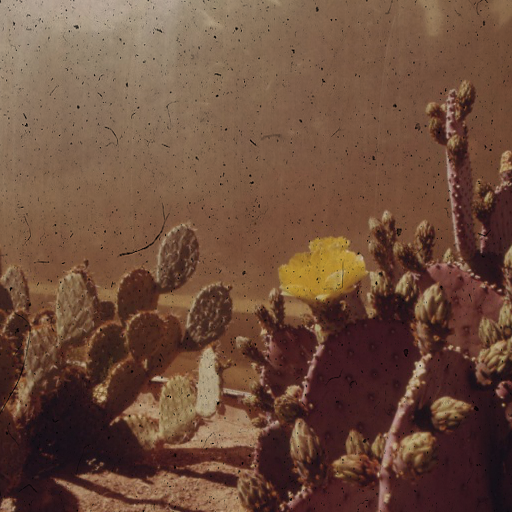

In [ ]:
src.train[97]

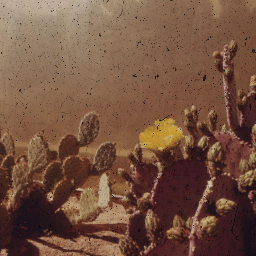

In [ ]:
src_256.train[97]

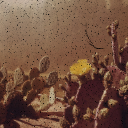

In [ ]:
src_128.train[97]

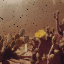

In [ ]:
src_64.train[97]

In [ ]:
def plots_f(img, rows, cols, width, height, **kwargs):
    [img.apply_tfms(tfms_gen[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

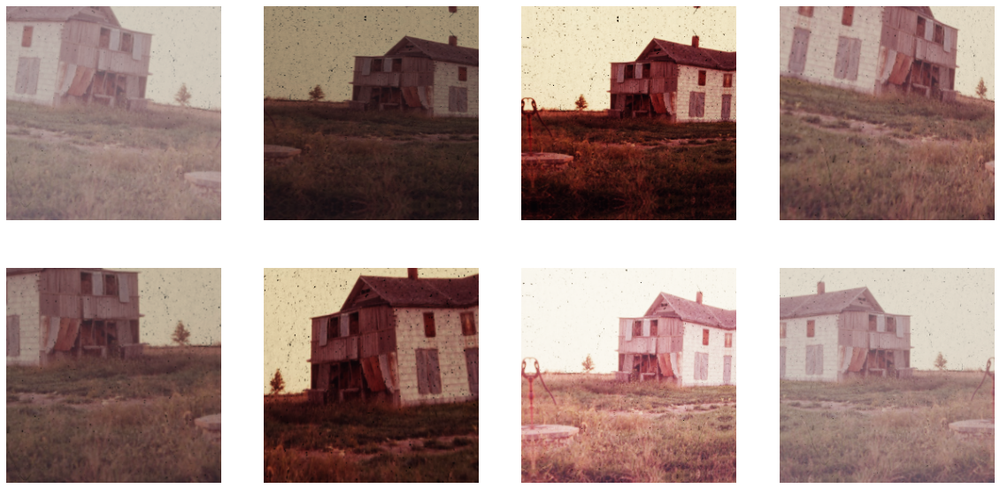

In [ ]:
plots_f(src_256.train[4], 2, 4, 20, 10)

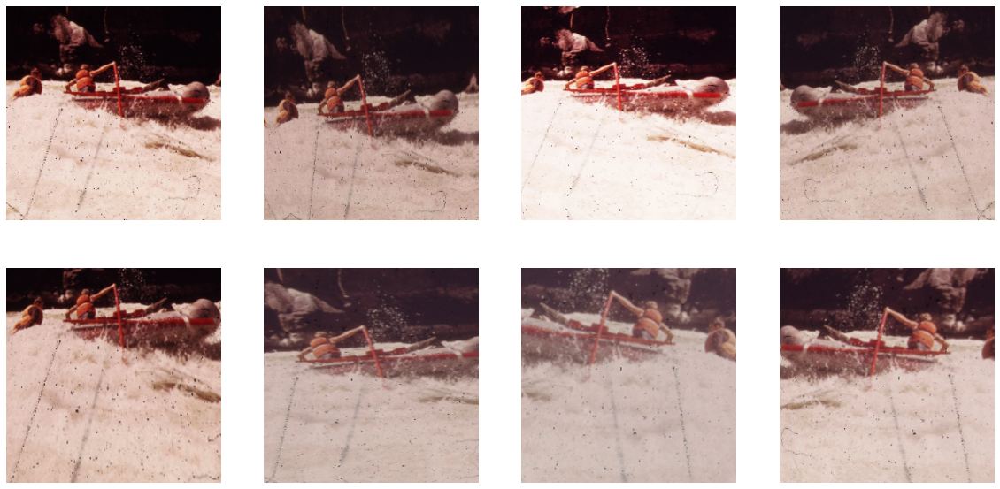

In [ ]:
plots_f(src_256.train[100], 2, 4, 20, 10)

We also create another ImageImageList which will hold the test set so that we can use `learn.validate()` on it. Fastai only allows for ground truth labels in validation.

In [ ]:
src_test = ImageImageList.from_df(df=df_images, path=path_lr, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /content/drive/My Drive/documerica/dataset/dustified_512;

Valid: ImageImageList (624 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /content/drive/My Drive/documerica/dataset/dustified_512;

Test: None

In [ ]:
src_test_256 = ImageImageList.from_df(df=df_images, path=path_lr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_256

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/dustified_256;

Valid: ImageImageList (624 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/dustified_256;

Test: None

In [ ]:
src_test_128 = ImageImageList.from_df(df=df_images, path=path_lr_128, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_128

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Valid: ImageImageList (624 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Test: None

In [ ]:
src_test_64 = ImageImageList.from_df(df=df_images, path=path_lr_64, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_64

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Valid: ImageImageList (624 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Test: None

This is a helper function which will map the dusty images to their corresponding clean image, apply the chosen transformations to both, load them in a *DataBunch* object and normalize them using the dataset statistics (std and mean) which are calculated automatically. We pass the batch size and image size as well as the transforms of choice as arguments. Same transforms and normalization are applied both to the dusty and the clean images.

In [ ]:
def get_data(src, bs, size, tfms, path_hr):
    data = (src.label_from_func(lambda x: '{}/{}'.format(path_hr,os.path.basename(x))) # Ensure that we get the matching clean image for each dusty one
           .transform(tfms, size=size, tfm_y=True)
           .databunch(bs=bs).normalize(do_y=True))
    data.c = 3
    return data

I've monkey patched the fastai show results function so that it also displays the normalised difference between ground truth and prediction.

In [ ]:
def show_xyzdiffs(self, xs, ys, zs, imgsize:int=4, figsize:Optional[Tuple[int,int]]=None, **kwargs):
        "Show `xs` (inputs), `ys` (targets), `zs` (predictions) and `diffs` (differences)  on a figure of `figsize`."
        title = 'Input / Prediction / Target / Difference'
        axs = subplots(len(xs), 4, imgsize=imgsize, figsize=figsize, title=title, weight='bold', size=14)
        for i,(x,y,z) in enumerate(zip(xs,ys,zs)):
            x.show(ax=axs[i,0], **kwargs)
            y.show(ax=axs[i,2], **kwargs)
            z.show(ax=axs[i,1], **kwargs)
            np_diff = np.subtract(z.data.numpy(), y.data.numpy()).astype(np.float32)
            np_diff = (np_diff - np.min(np_diff))/np.ptp(np_diff)
            diff = Image(torch.from_numpy(np_diff).to(device))
            diff.show(ax=axs[i,3], **kwargs)

In [ ]:
def _show_results(self, ds_type=DatasetType.Valid, rows:int=5, **kwargs):
        "Show `rows` result of predictions on `ds_type` dataset."
        #TODO: get read of has_arg x and split_kwargs_by_func if possible
        #TODO: simplify this and refactor with pred_batch(...reconstruct=True)
        n_items = rows ** 2 if self.data.train_ds.x._square_show_res else rows
        if self.dl(ds_type).batch_size < n_items: n_items = self.dl(ds_type).batch_size
        ds = self.dl(ds_type).dataset
        self.callbacks.append(RecordOnCPU())
        preds = self.pred_batch(ds_type)
        *self.callbacks,rec_cpu = self.callbacks
        x,y = rec_cpu.input,rec_cpu.target
        norm = getattr(self.data,'norm',False)
        if norm:
            x = self.data.denorm(x)
            if norm.keywords.get('do_y',False):
                y     = self.data.denorm(y, do_x=True)
                preds = self.data.denorm(preds, do_x=True)
        analyze_kwargs,kwargs = split_kwargs_by_func(kwargs, ds.y.analyze_pred)
        preds = [ds.y.analyze_pred(grab_idx(preds, i), **analyze_kwargs) for i in range(n_items)]
        xs = [ds.x.reconstruct(grab_idx(x, i)) for i in range(n_items)]
        if has_arg(ds.y.reconstruct, 'x'):
            ys = [ds.y.reconstruct(grab_idx(y, i), x=x) for i,x in enumerate(xs)]
            zs = [ds.y.reconstruct(z, x=x) for z,x in zip(preds,xs)]
        else :
            ys = [ds.y.reconstruct(grab_idx(y, i)) for i in range(n_items)]
            zs = [ds.y.reconstruct(z) for z in preds]
        show_xyzdiffs(ds.x, xs, ys, zs, **kwargs)

# Hyperparams
These parameters are shared between all U-nets during progressive resizing.

The loss function we will use is Feature Loss.

For the architecture for the backbone if the U-Net we will use as our generator we choose *ResNet34* - ideally *ResNet50* or an even deeper ResNet could be used, but we run out of CUDA memory very quickly in that case and need to reset the notebook.

The chosen default weight decay is 1e-3, as this is advised as a good starting point for this hyperparameter in the fast.ai docs and tutorials. It will be handled using the method from "Fixing Weight Decay Regularization in Adam" ([paper](https://arxiv.org/abs/1711.05101)).

The parameter y_range corresponds to a sigmoid function applied to the activations obtained at the last step. These values are again the suggested default ones from the fast.ai docs and tutorials.

In [ ]:
arch = models.resnet34
wd = 1e-03 # weight decay
y_range = (-3.,3.)


In [ ]:
def ssim_metric(inputs, targets, window_size=7, size_average = True):
    ssim_metric = pytorch_ssim.ssim(inputs, targets, window_size, size_average)
    return ssim_metric

In [ ]:
class SSIM_metric(Callback):
    "Wrap a `func` in a callback for metrics computation."
    def __init__(self, func):
        # If it's a partial, use func.func
        name = getattr(func,'func',func).__name__
        self.func, self.name = func, name

    def on_epoch_begin(self, **kwargs):
        "Set the inner value to 0."
        self.val, self.count = 0.,0

    def on_batch_end(self, last_output, last_target, **kwargs):
        "Update metric computation with `last_output` and `last_target`."
        if not is_listy(last_target): last_target=[last_target]
        self.count += last_target[0].size(0)
        val = self.func(last_output, *last_target)
        self.val += last_target[0].size(0) * val.detach().cpu()

    def on_epoch_end(self, last_metrics, **kwargs):
        "Set the final result in `last_metrics`."
        return add_metrics(last_metrics, self.val/self.count)

# Feature Loss
This is a more complex loss function, using inverted Structural Similarity Index, perceptual loss and gram matrix loss.

In [ ]:
def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [ ]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/checkpoints/vgg16_bn-6c64b313.pth


In [ ]:
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]
blocks, [vgg_m[i] for i in blocks]

([5, 12, 22, 32, 42],
 [ReLU(inplace=True),
  ReLU(inplace=True),
  ReLU(inplace=True),
  ReLU(inplace=True),
  ReLU(inplace=True)])

In [ ]:
def ssim_loss(inputs, targets, window_size=7, size_average = True, **kwargs):
    ssim_loss = 1 - pytorch_ssim.ssim(inputs, targets, window_size, size_average)
    return ssim_loss
    

class SSIM_loss(nn.Module):
    def __init__(self, window_size=11, size_average=True, per_channel=True):
        super().__init__()
        self.size_average = size_average
        self.window_size = window_size
        self.per_channel = per_channel
        
    def forward(self, input, target, **kwargs):
        ssim_per_chan = 0
        if self.per_channel:
            input_channels = torch.chunk(input,3,1)
            target_channels = torch.chunk(target,3,1)
            for i in range(3):
                ssim_per_chan += ssim_loss(input_channels[i], target_channels[i], window_size=self.window_size, size_average=self.size_average, **kwargs)
            return ssim_per_chan/3
        
        else:
            return ssim_loss(input, target, window_size=self.window_size, size_average=self.size_average, **kwargs)

In [ ]:
class FeatureLoss(nn.Module):
    def __init__(self, base_loss, ssim_los, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.base_loss = base_loss
        self.ssim_loss = ssim_loss
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['abs', 'ssim'] + [f'ssim_feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [self.base_loss(input,target), self.ssim_loss(input, target)]
        self.feat_losses += [self.ssim_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [self.base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [ ]:
loss_gen = FeatureLoss(F.l1_loss, SSIM_loss(per_channel=False, window_size=5), vgg_m, blocks, [2,4,5,6,6])

#loss_gen = SSIM_loss()

# First generator
## Progressive resizing stage one - 64 by 64 pixels
Our first generator will be a U-Net which will be trained on images of size 64 by 64 pixels.

In [ ]:
data_gen = get_data(src_64, 32, 64, tfms_gen, path_hr_64)

In [ ]:
data_gen

ImageDataBunch;

Train: LabelList (4985 items)
x: ImageImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
y: ImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Valid: LabelList (623 items)
x: ImageImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
y: ImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /content/drive/My Drive/documerica/dataset/dustified_64;

Test: None

Show a batch of the data we loaded to see examples of image pairs. Note that images are slightly enlarged when visualised here so that we can see damaged sections a bit better.

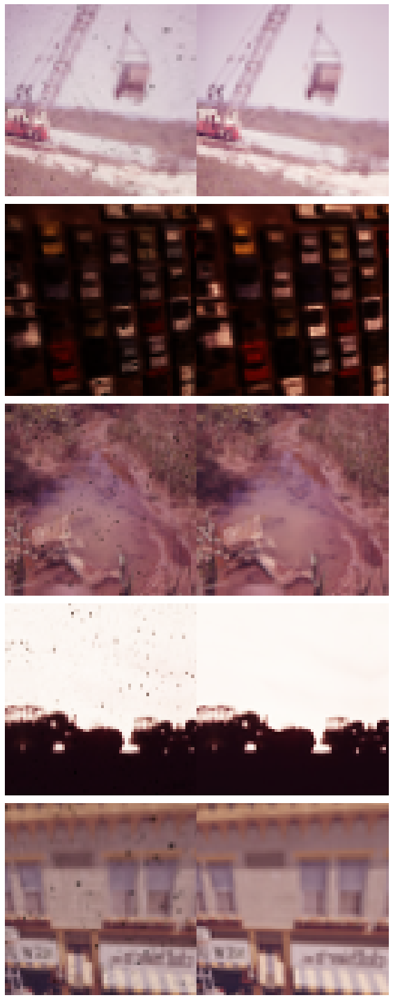

In [ ]:
data_gen.show_batch()

Connect to the wandb project instance for visualising and logging network performance.

In [ ]:
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', 'stage1', experiment_id])

W&B Run: https://app.wandb.ai/daniela-ivanova/FeatLoss%2BSSIM/runs/2j5j8uz3

The first generator is a U-Net with a ResNet34 backbone which takes 64 by 64 images as input. 

Self-attention is added via a self-attention layer at the third block before the end - idea from paper "Self-Attention Generative Adversarial Networks" ([paper](https://arxiv.org/abs/1805.08318)). 

Blur is used to avoid checkerboard artifacts at each layer - idea from "Super-Resolution using Convolutional Neural Networks without Any Checkerboard Artifacts" ([paper](https://arxiv.org/abs/1806.02658)). 

We also use weight normalization as suggested in the fast.ai tutorials for super resolution, since this is a similar task. "On the Effects of Batch and Weight Normalization in Generative Adversarial Networks" ([paper](https://arxiv.org/abs/1704.03971)) is a paper which supports the usage of weight normalisation for GANs.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, path=path, loss_func=loss_gen, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).to_fp16()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


Print a summary of the network. We can see that not all parameters are trainable - all layer groups in the network are frozen but the last. The network is using weights from a *ResNet34* trained on ImageNet (provided by PyTorch), so we freeze the earlier layers that have already learned representations found in "natural" images (the encoder) and fine-tune the latter layers to the specific task of removing dust and scratches (the decoder part of the U-shape).

In [ ]:
generator.loss_func = loss_gen

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 32, 32]         9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 32, 32]         128        True      
______________________________________________________________________
ReLU                 [64, 32, 32]         0          False     
______________________________________________________________________
MaxPool2d            [64, 16, 16]         0          False     
______________________________________________________________________
Conv2d               [64, 16, 16]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 16, 16]         128        True      
______________________________________________________________________
ReLU                 [64, 16, 16]         0          False     
__________________________________________________

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


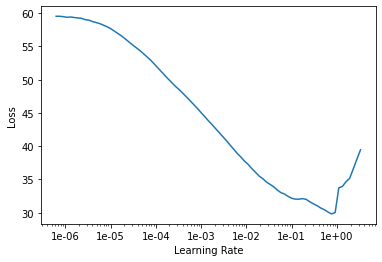

In [ ]:
generator.lr_find()
generator.recorder.plot()

We pass a *WandbCallback* instance so that the network training and validation performance is logged. Image visualisatons of Input/Prediction/Ground truth will be logged for each validation pass at the end of each epoch. Parameters and weights are also logged.

In [ ]:
wandb.config.update({"batch size": 32, 
                     "image size": 64,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'SSIM',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

Finally, we can train the network for 10 epochs. 

We use one cycle policy to train the network more quickly. It is explaied in detail [here](https://docs.fast.ai/callbacks.one_cycle.html). 

We also set the percentage of overall number of iterations when learning rate rises during one cycle - in this case it is 80%.



The training and validation loss are recorded at the end of each epoch. The weights from the epoch with lowest validation loss will be automatically saved on the *wandb* instance (remote server).

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,abs,ssim,ssim_feat_0,ssim_feat_1,ssim_feat_2,ssim_feat_3,ssim_feat_4,gram_0,gram_1,gram_2,gram_3,gram_4,time
0,21.961065,18.994141,0.203639,0.077389,0.278008,0.574949,0.203639,0.425051,0.861594,2.009426,2.509452,2.513484,2.554876,1.417128,2.315475,1.094869,0.380688,2.708460,05:45
1,10.872624,10.825970,0.100490,0.022920,0.151272,0.798990,0.100490,0.201009,0.366680,1.018937,1.333968,1.363877,1.787472,0.575366,1.045137,0.593074,0.246359,2.193599,00:33
2,8.734396,9.369944,0.090696,0.018689,0.136595,0.822198,0.090696,0.177802,0.303026,0.869600,1.139379,1.153241,1.586771,0.488910,0.861443,0.513967,0.218316,1.966793,00:33
3,7.855667,8.351505,0.088319,0.016942,0.130020,0.839356,0.088319,0.160644,0.266435,0.752047,0.978972,0.980308,1.429540,0.475875,0.777092,0.456213,0.191744,1.794315,00:33
4,7.196908,7.953708,0.086510,0.015816,0.125611,0.848564,0.086510,0.151436,0.248966,0.708796,0.917149,0.924437,1.378891,0.443900,0.740876,0.436141,0.184791,1.731816,00:33
5,6.867331,7.554942,0.083267,0.014746,0.121269,0.851783,0.083267,0.148217,0.233416,0.675130,0.872266,0.871541,1.318823,0.404298,0.677074,0.416213,0.178181,1.676517,00:33
6,6.659665,7.275583,0.078353,0.013019,0.113965,0.864466,0.078353,0.135534,0.222937,0.653127,0.844421,0.836718,1.282681,0.358549,0.651203,0.404739,0.173455,1.633867,00:33
7,6.435186,7.543950,0.078776,0.013118,0.114362,0.866931,0.078776,0.133069,0.225922,0.652966,0.845987,0.855168,1.310221,0.490449,0.690499,0.413126,0.177345,1.670421,00:34
8,6.173841,6.890162,0.075043,0.012260,0.110552,0.869577,0.075043,0.130423,0.208930,0.616833,0.794375,0.787231,1.222699,0.342853,0.595507,0.381578,0.166267,1.568423,00:33
9,5.973797,6.761177,0.074073,0.011989,0.109332,0.872160,0.074073,0.127840,0.203740,0.604728,0.779342,0.772280,1.204024,0.318831,0.585995,0.376540,0.164048,1.549736,00:33


Better model found at epoch 0 with valid_loss value: 18.994140625.
Better model found at epoch 1 with valid_loss value: 10.825969696044922.
Better model found at epoch 2 with valid_loss value: 9.369943618774414.
Better model found at epoch 3 with valid_loss value: 8.351505279541016.
Better model found at epoch 4 with valid_loss value: 7.953708171844482.
Better model found at epoch 5 with valid_loss value: 7.5549421310424805.
Better model found at epoch 6 with valid_loss value: 7.275583267211914.
Better model found at epoch 8 with valid_loss value: 6.890162467956543.
Better model found at epoch 9 with valid_loss value: 6.761177062988281.
Loaded best saved model from /content/wandb/run-20200404_010651-2j5j8uz3/bestmodel.pth


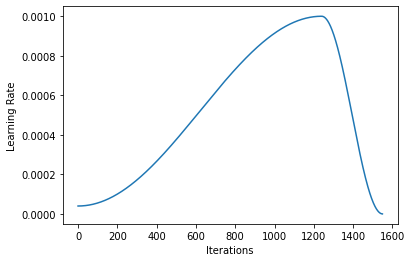

In [ ]:
generator.recorder.plot_lr()

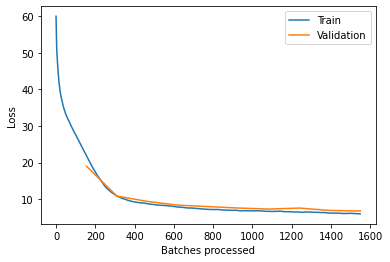

In [ ]:
generator.recorder.plot_losses()

Once training finishes, visualise results from the validation set.

In [ ]:
generator.show_results = _show_results

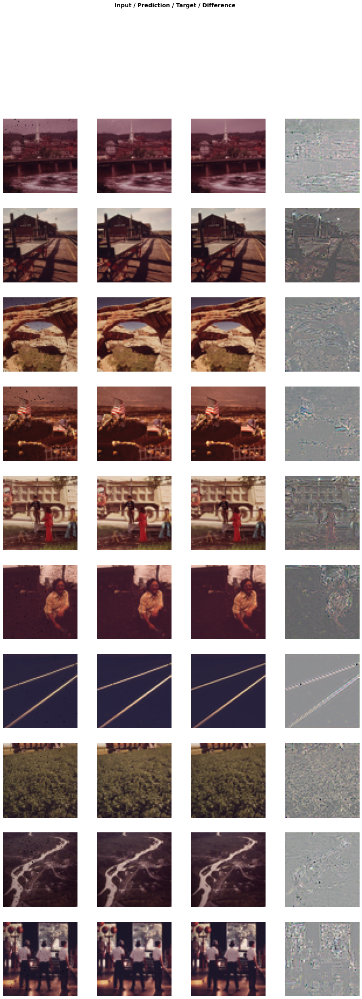

In [ ]:
generator.show_results(generator, rows=10)

To save the model weights, run this.

In [ ]:
generator.save('gen-pre-64-frozen-'+experiment_id)

Show results on test set.

# Second generator
## Progressive resizing stage 2 - 128 by 128 pixels
The second generator is again a U-Net with *ResNet34* backbone. It takes 128 by 128 pixel image input. It will incorporate the weights and layers from the previous, smaller network that was trained.


In [ ]:
data_gen = get_data(src_128, 16, 128, tfms_gen, path_hr_128)

In [ ]:
data_gen

ImageDataBunch;

Train: LabelList (4985 items)
x: ImageImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Valid: LabelList (623 items)
x: ImageImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /content/drive/My Drive/documerica/dataset/dustified_128;

Test: None

Display image pairs from a random batch. 

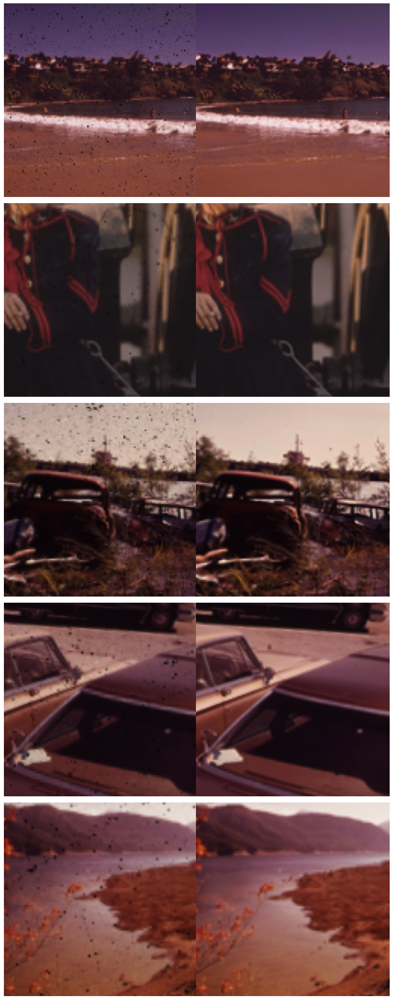

In [ ]:
data_gen.show_batch(imgsize=5)

Update the *wandb* run.

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', 'stage2', experiment_id])

W&B Run: https://app.wandb.ai/daniela-ivanova/FeatLoss%2BSSIM/runs/2mnb6t8s

Now create the new generator with the dataset of larger images. The hyperparameters are the same as in the first U-Net. We also use the weights from the previous network - *fast.ai* automatically takes care of incorporating them into the larger U-Net at the corresponding layers. We load the weights from the network run which had the smallest validation loss.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-64-frozen-'+experiment_id).to_fp16()

Print the network summary. Not all parameters are trainable (frozen).

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 64, 64]         9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
______________________________________________________________________
MaxPool2d            [64, 32, 32]         0          False     
______________________________________________________________________
Conv2d               [64, 32, 32]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 32, 32]         128        True      
______________________________________________________________________
ReLU                 [64, 32, 32]         0          False     
__________________________________________________

Train the generator and use a *WandbCallback* to record logs.

In [ ]:
wandb.config.update({"batch size": 16, 
                     "image size": 128,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'FeatureLoss(Perceptual Loss w/ VGG16, gram matrix, SSIM)',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,abs,ssim,ssim_feat_0,ssim_feat_1,ssim_feat_2,ssim_feat_3,ssim_feat_4,gram_0,gram_1,gram_2,gram_3,gram_4,time
0,5.705508,6.501866,0.070214,0.010689,0.103125,0.851322,0.070214,0.148678,0.237368,0.728965,0.941445,0.851672,1.366221,0.309878,0.487976,0.233101,0.082627,1.043721,15:38
1,5.503754,6.378414,0.070019,0.010651,0.102895,0.853712,0.070019,0.146288,0.231294,0.713025,0.924211,0.837820,1.351928,0.300991,0.455966,0.227465,0.081297,1.038112,01:41
2,5.456738,6.330997,0.073476,0.011588,0.107218,0.857287,0.073476,0.142713,0.230491,0.702686,0.907026,0.817514,1.321270,0.357543,0.460075,0.221716,0.078960,1.017527,01:41
3,5.281905,6.220771,0.072218,0.011172,0.105349,0.862818,0.072218,0.137182,0.224227,0.683310,0.884372,0.800134,1.311438,0.358189,0.444196,0.212238,0.076503,1.016764,01:41
4,5.332120,5.873294,0.067846,0.009680,0.098147,0.869635,0.067846,0.130365,0.211311,0.652555,0.842708,0.753459,1.243075,0.322942,0.409969,0.201324,0.072569,0.965172,01:41
5,5.196279,6.126351,0.076039,0.012301,0.110404,0.867836,0.076039,0.132164,0.218114,0.671487,0.870491,0.787728,1.290884,0.337745,0.449773,0.208841,0.075525,1.007559,01:41
6,5.149209,5.768732,0.067863,0.009761,0.098470,0.873584,0.067863,0.126416,0.206101,0.640280,0.831178,0.743232,1.228425,0.306576,0.392097,0.199072,0.072010,0.955482,01:41
7,5.023214,5.544719,0.065433,0.008862,0.093918,0.880274,0.065433,0.119726,0.196102,0.612949,0.792155,0.705276,1.183763,0.299655,0.380867,0.189675,0.068987,0.930130,01:41
8,4.753935,5.579294,0.068280,0.009380,0.096580,0.872865,0.068280,0.127135,0.200470,0.620078,0.802309,0.716353,1.194735,0.288833,0.371163,0.182767,0.068276,0.938896,01:41
9,4.455140,5.252326,0.062413,0.008476,0.091756,0.883435,0.062413,0.116565,0.190605,0.596775,0.768610,0.677628,1.138795,0.229468,0.329739,0.173497,0.065306,0.902924,01:41


Better model found at epoch 0 with valid_loss value: 6.501866340637207.
Better model found at epoch 1 with valid_loss value: 6.378414154052734.
Better model found at epoch 2 with valid_loss value: 6.330996990203857.
Better model found at epoch 3 with valid_loss value: 6.220771312713623.
Better model found at epoch 4 with valid_loss value: 5.873293876647949.
Better model found at epoch 6 with valid_loss value: 5.768732070922852.
Better model found at epoch 7 with valid_loss value: 5.544719219207764.
Better model found at epoch 9 with valid_loss value: 5.252326011657715.
Loaded best saved model from /content/wandb/run-20200404_013350-2mnb6t8s/bestmodel.pth


In [ ]:
generator.show_results = _show_results

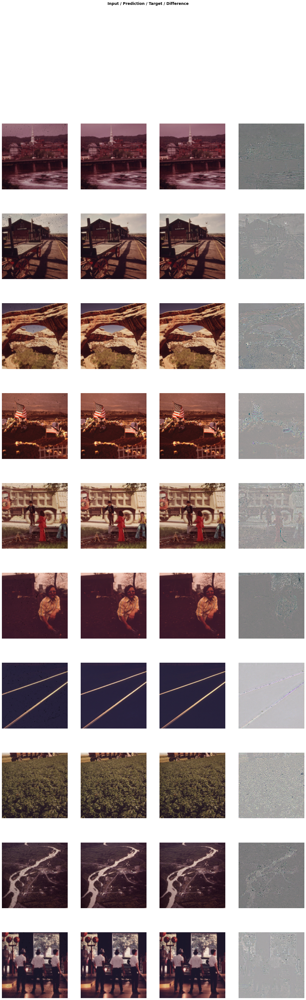

In [ ]:
generator.show_results(generator, rows=10, figsize=(20,60))

Save the network.

In [ ]:
generator.save('gen-pre-128-frozen-'+experiment_id)

Show results on test set.

In [ ]:
del generator
del data_gen

# Third Generator
## Progressive resizing stage 3 - 256 by 256 pixels
The next stage of progressive resizing is to train a U-Net generator which takes 256 by 256 pixel images as input.

In [ ]:
data_gen = get_data(src_256, 8, 256, tfms, path_hr_256)

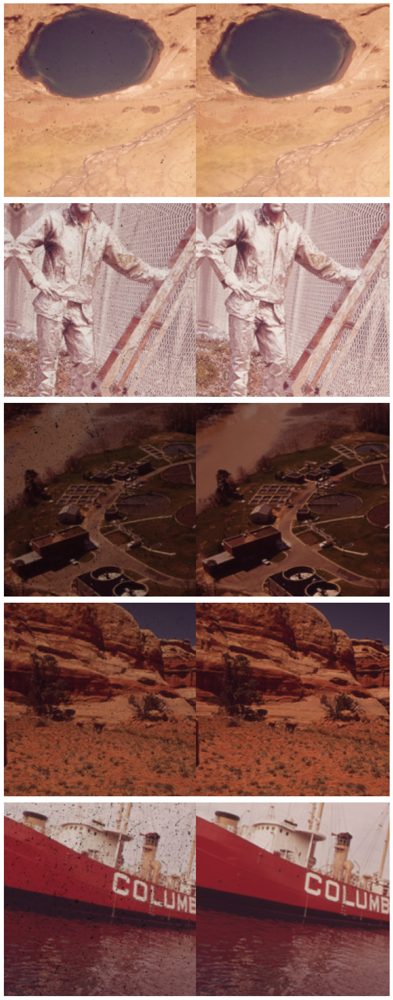

In [ ]:
data_gen.show_batch(imgsize=5)

Then load new generator with 256 pixel input using the weights learned by the U-Net with 128 pixel input.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-128-frozen-'+experiment_id).to_fp16()

Print generator summary.

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 128, 128]       9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 128, 128]       128        True      
______________________________________________________________________
ReLU                 [64, 128, 128]       0          False     
______________________________________________________________________
MaxPool2d            [64, 64, 64]         0          False     
______________________________________________________________________
Conv2d               [64, 64, 64]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
__________________________________________________

Append wandb to the network's callbacks.

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', experiment_id])

W&B Run: https://app.wandb.ai/daniela-ivanova/FeatLoss%2BSSIM/runs/1zyhh8k7

In [ ]:
wandb.config.update({"batch size": 8, 
                     "image size": 256,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'SSIM',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

Train the generator on new data.

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,abs,ssim,ssim_feat_0,ssim_feat_1,ssim_feat_2,ssim_feat_3,ssim_feat_4,gram_0,gram_1,gram_2,gram_3,gram_4,time
0,4.445972,4.918407,0.056836,0.007231,0.084551,0.877250,0.056836,0.122750,0.209771,0.691984,0.906003,0.723072,1.072613,0.215625,0.296545,0.117646,0.035547,0.470013,16:23
1,4.518309,4.869237,0.059639,0.007724,0.087295,0.875408,0.059639,0.124592,0.207407,0.681749,0.888881,0.708198,1.054910,0.232790,0.295992,0.115357,0.034964,0.464758,06:39
2,4.402398,4.944649,0.063547,0.008984,0.094018,0.877863,0.063547,0.122137,0.209319,0.682535,0.888576,0.707587,1.053265,0.278992,0.319136,0.119962,0.035069,0.464526,06:39
3,4.405369,4.964538,0.064362,0.009167,0.094974,0.874686,0.064362,0.125314,0.206609,0.688323,0.905650,0.721420,1.069740,0.246587,0.311202,0.119863,0.035116,0.470352,06:39
4,4.489872,4.832716,0.062955,0.008005,0.088922,0.878865,0.062955,0.121135,0.200705,0.661294,0.866121,0.690204,1.030176,0.264561,0.329528,0.116305,0.034501,0.455229,06:39
5,4.455493,4.937998,0.060607,0.008088,0.089342,0.876011,0.060607,0.123989,0.206728,0.673452,0.877920,0.702744,1.051631,0.292528,0.334654,0.115636,0.034432,0.463679,06:39
6,4.416110,4.680236,0.058300,0.007387,0.085191,0.885802,0.058300,0.114198,0.197119,0.649396,0.844855,0.669477,1.009238,0.246043,0.297732,0.112746,0.033320,0.447813,06:39
7,4.480845,4.649955,0.058141,0.007477,0.085709,0.881368,0.058141,0.118632,0.195389,0.649659,0.849289,0.670966,1.005334,0.234449,0.277851,0.110864,0.032951,0.446432,06:40
8,4.113752,4.569438,0.054691,0.006543,0.080155,0.890270,0.054691,0.109730,0.191444,0.633832,0.827697,0.655474,0.987465,0.241937,0.290727,0.105796,0.032276,0.438368,06:40
9,3.971518,4.278898,0.052496,0.006355,0.078843,0.892345,0.052496,0.107655,0.183047,0.612289,0.795780,0.624393,0.943995,0.173641,0.236241,0.097258,0.030492,0.421612,06:39


Better model found at epoch 0 with valid_loss value: 4.918407440185547.
Better model found at epoch 1 with valid_loss value: 4.869237422943115.
Better model found at epoch 4 with valid_loss value: 4.8327155113220215.
Better model found at epoch 6 with valid_loss value: 4.680236339569092.
Better model found at epoch 7 with valid_loss value: 4.6499552726745605.
Better model found at epoch 8 with valid_loss value: 4.569437503814697.
Better model found at epoch 9 with valid_loss value: 4.278897762298584.
Loaded best saved model from /content/wandb/run-20200404_021451-1zyhh8k7/bestmodel.pth


In [ ]:
generator.show_results = _show_results

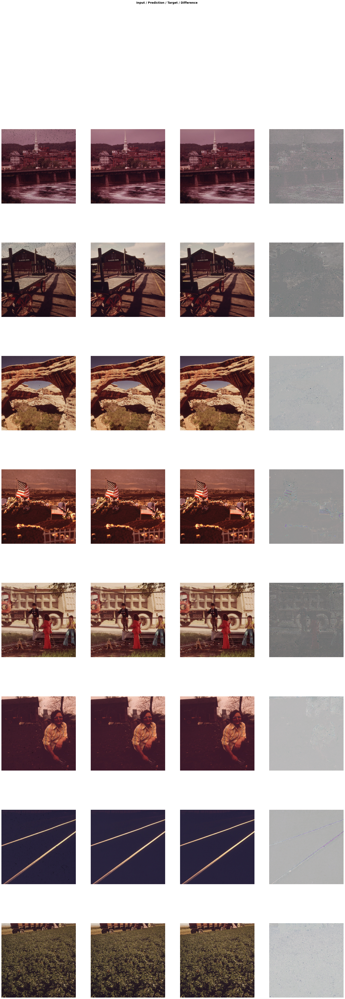

In [ ]:
generator.show_results(generator, rows=10, figsize=(30,80))

Save the network.

In [ ]:
generator.save('gen-pre-256-frozen-'+experiment_id)

Validate on the test set.

In [ ]:
del generator
del data_gen

# Unfreeze
Now we will unfreeze the pre-trained weights and train them as well.

In [ ]:
data_gen = get_data(src_256, 8, 256, tfms_gen, path_hr_256)

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', 'phase4', experiment_id])

<IPython.core.display.Javascript object>

wandb: ERROR Not authenticated.  Copy a key from https://app.wandb.ai/authorize


API Key: ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


W&B Run: https://app.wandb.ai/daniela-ivanova/FeatLoss%2BSSIM/runs/3f8iiscc

Then load new generator with 256 pixel input using the weights learned from fine-tuning.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-256-frozen-'+experiment_id).to_fp16()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


Print generator summary.

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 128, 128]       9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 128, 128]       128        True      
______________________________________________________________________
ReLU                 [64, 128, 128]       0          False     
______________________________________________________________________
MaxPool2d            [64, 64, 64]         0          False     
______________________________________________________________________
Conv2d               [64, 64, 64]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
__________________________________________________

In [ ]:
generator.unfreeze()

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 128, 128]       9,408      True      
______________________________________________________________________
BatchNorm2d          [64, 128, 128]       128        True      
______________________________________________________________________
ReLU                 [64, 128, 128]       0          False     
______________________________________________________________________
MaxPool2d            [64, 64, 64]         0          False     
______________________________________________________________________
Conv2d               [64, 64, 64]         36,864     True      
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
__________________________________________________

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


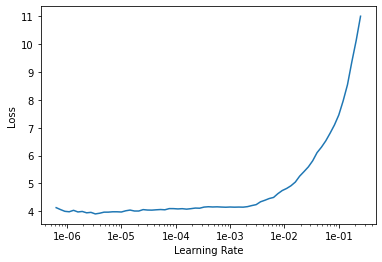

In [ ]:
generator.lr_find()
generator.recorder.plot()

In [ ]:
wandb.config.update({"batch size": 8, 
                     "image size": 256,
                     "number epochs": 20,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.5,
                     "weight_decay": 1e-03,
                     "max_lr": 'slice(1e-5,1e-3)',
                     "loss": 'SSIM',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": False,
                     "half-precision": True}, allow_val_change=True)

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

Train the generator.

In [ ]:
generator.fit_one_cycle(20, pct_start=0.5, max_lr=slice(1e-5,1e-3))

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,abs,ssim,ssim_feat_0,ssim_feat_1,ssim_feat_2,ssim_feat_3,ssim_feat_4,gram_0,gram_1,gram_2,gram_3,gram_4,time
0,3.878999,4.363428,0.055016,0.006732,0.081163,0.888217,0.055016,0.111783,0.190393,0.627932,0.817690,0.637690,0.956868,0.181144,0.236489,0.099310,0.030885,0.418226,10:34
1,3.960502,4.363297,0.054945,0.006882,0.082080,0.885190,0.054945,0.114810,0.189663,0.627114,0.816287,0.636328,0.956826,0.183088,0.236596,0.098522,0.030687,0.418431,07:11
2,3.889569,4.372207,0.052274,0.006210,0.078121,0.888064,0.052274,0.111936,0.189209,0.624947,0.814372,0.636037,0.955205,0.193426,0.249460,0.098369,0.030754,0.416218,07:11
3,3.949995,4.596247,0.058653,0.007360,0.085031,0.879107,0.058653,0.120893,0.196355,0.639926,0.833226,0.654984,0.986513,0.273530,0.267623,0.103484,0.031647,0.429411,07:11
4,4.030120,4.539669,0.055031,0.006816,0.081759,0.884454,0.055031,0.115546,0.194336,0.635424,0.830608,0.655726,0.985083,0.226642,0.278956,0.103155,0.031120,0.428043,07:11
5,4.013124,4.522664,0.056424,0.007252,0.084180,0.881727,0.056424,0.118273,0.195186,0.640541,0.834405,0.653328,0.983790,0.217956,0.256298,0.102899,0.031645,0.431918,07:11
6,4.083738,4.736345,0.066249,0.009689,0.097058,0.868776,0.066249,0.131224,0.199757,0.654425,0.858574,0.679734,1.017471,0.251294,0.296363,0.108187,0.032662,0.440404,07:11
7,4.123368,4.703179,0.066874,0.009061,0.094175,0.865716,0.066874,0.134284,0.202571,0.656854,0.857969,0.675326,1.007074,0.245048,0.283194,0.106358,0.032241,0.435385,07:11
8,4.061252,4.537515,0.059574,0.007872,0.087624,0.878653,0.059574,0.121347,0.193075,0.636042,0.831666,0.654754,0.982196,0.214417,0.280803,0.105155,0.031870,0.426615,07:12
9,4.077092,4.703818,0.064375,0.008825,0.092797,0.876137,0.064375,0.123863,0.197549,0.637790,0.836389,0.662399,0.995802,0.309166,0.298390,0.109837,0.032476,0.435781,07:12


Better model found at epoch 0 with valid_loss value: 4.363427639007568.
Better model found at epoch 1 with valid_loss value: 4.363297462463379.
Better model found at epoch 11 with valid_loss value: 4.317784309387207.
Buffered data was truncated after reaching the output size limit.

In [ ]:
generator.show_results = _show_results

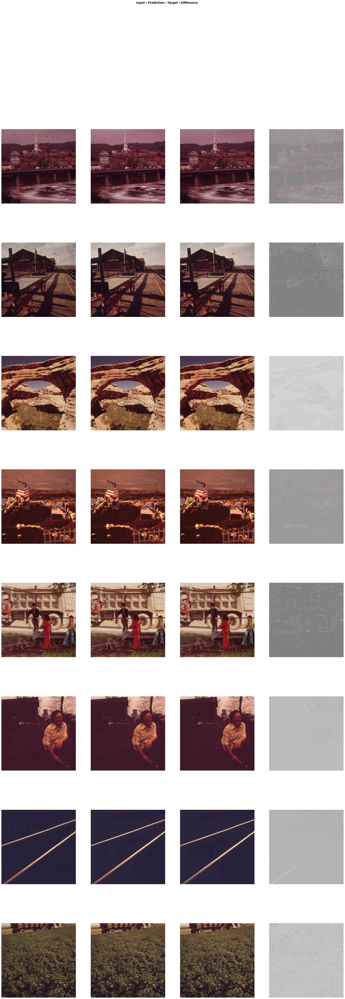

In [ ]:
generator.show_results(generator, rows=10, figsize=(30,80))

Save the network.

In [ ]:
generator.save('gen-pre-256-unfrozen-'+experiment_id)

In [ ]:
wandb.join()

In [ ]:
del generator
del data_gen

# Evaluate generator on test data

In [ ]:
src_test_256_clean = ImageImageList.from_df(df=df_images, path=path_hr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_256_clean

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/clean_256;

Valid: ImageImageList (624 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /content/drive/My Drive/documerica/dataset/clean_256;

Test: None

In [ ]:
tfms_test = get_transforms(do_flip=False, max_zoom=1., max_lighting=None, max_rotate=None, max_warp=None)

In [ ]:
data_gen_test = get_data(src_test_256, 1, 256, tfms_test, path_hr_256)

In [ ]:
data_gen_test_clean = get_data(src_test_256_clean, 1, 256, tfms_test, path_hr_256)

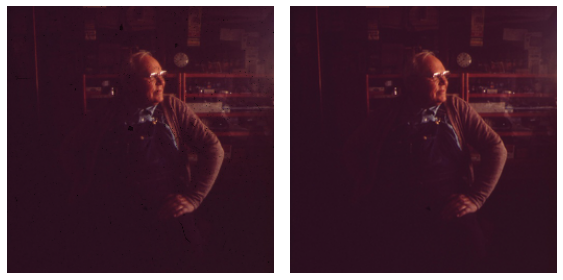

In [ ]:
data_gen_test.show_batch()

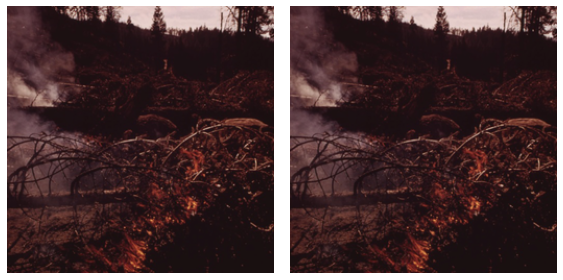

In [ ]:
data_gen_test_clean.show_batch()

In [ ]:
def ssim_eval(inputs, targets, window_size=3, size_average = True, **kwargs):
    ssim = pytorch_ssim.ssim(inputs, targets, window_size, size_average)
    return ssim
    

class SSIM_metric_eval(nn.Module):
    def __init__(self, window_size=7, size_average=True, per_channel=False):
        super().__init__()
        self.size_average = size_average
        self.window_size = window_size
        self.per_channel = per_channel
        
    def forward(self, input, target, **kwargs):
        ssim_per_chan = []
        ssim_per_chan.append(ssim_eval(input, target, window_size=self.window_size, size_average=self.size_average, **kwargs))
        if self.per_channel:
            input_channels = torch.chunk(input,3,1)
            target_channels = torch.chunk(target,3,1)
            for i in range(3):
                ssim_per_chan.append(ssim_eval(input_channels[i], target_channels[i], window_size=self.window_size, size_average=self.size_average, **kwargs))
        return torch.Tensor(ssim_per_chan)

In [ ]:
def ssim_init(data1, data2):
    ssim_dusty_clean = []
    ssim_clean_clean = []
    for i in iter(data1.valid_dl):
        ssim_dusty_clean.append(ssim_eval(i[0],i[1]).item())
    
    for i in iter(data2.valid_dl):
        ssim_clean_clean.append(ssim_eval(i[0],i[1]).item())
        
    return pd.DataFrame({'SSIM(clean, clean)': ssim_clean_clean, 'SSIM(dusty, clean)': ssim_dusty_clean})

In [ ]:
ssim_data = ssim_init(data_gen_test, data_gen_test_clean)

In [ ]:
ssim_data

,"SSIM(clean, clean)","SSIM(dusty, clean)"
0,1.0,0.662242
1,1.0,0.758344
2,1.0,0.675155
3,1.0,0.520921
4,1.0,0.828438
...,...,...
619,1.0,0.626210
620,1.0,0.686578
621,1.0,0.713903
622,1.0,0.700374


In [ ]:
from matplotlib.lines import Line2D

def plot_ssim(df, n_rows, n_cols, title, x_label, y_label, colours, figsize=(15,5)):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
    for i, c in enumerate(df.columns):
        curr_ax = df[c].plot(kind='hist', ax=axes.flatten()[i], figsize=figsize, title=c, bins=100, color=colours[i], range=(0.0, 1.0))
        if df[c].mean() != 1:
            curr_ax.axvline(df[c].mean(), color='k', linestyle='dashed', linewidth=1)
            curr_ax.axvline(df[c].mean()+df[c].std(), color='k', linestyle='dotted', linewidth=1)
            curr_ax.axvline(df[c].mean()-df[c].std(), color='k', linestyle='dotted', linewidth=1)
            min_ylim, max_ylim = plt.ylim()
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(df[c].mean()))
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.8, 'SD: {:.2f}'.format(df[c].std()))
            lines = [Line2D([0], [0], color='k', linewidth=3, linestyle='dashed'), Line2D([0], [0], color='k', linestyle='dotted')]
            labels = ['Mean: {:.2f}'.format(df[c].mean()), 'SD: {:.2f}'.format(df[c].std())]
            curr_ax.legend(lines, labels, loc="upper left")
    plt.suptitle(title, x=0.5, y=1.05, ha='center', fontsize='x-large')
    for ax in axes.flatten():
        ax.grid(False)
    fig.text(0.5, 0.001, x_label, ha='center', fontsize='larger')

In [ ]:
def plot_delta(df, n_rows, n_cols, title, x_label, y_label, colours, figsize=(15,5)):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
    for i, c in enumerate(df.columns):
        curr_ax = df[c].plot(kind='hist', ax=axes, figsize=figsize, title=c, bins=100, color=colours[i], range=(-0.5, 0.5))
        if df[c].mean() != 1:
            curr_ax.axvline(df[c].mean(), color='k', linestyle='dashed', linewidth=1)
            curr_ax.axvline(df[c].mean()+df[c].std(), color='k', linestyle='dotted', linewidth=1)
            curr_ax.axvline(df[c].mean()-df[c].std(), color='k', linestyle='dotted', linewidth=1)
            min_ylim, max_ylim = plt.ylim()
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(df[c].mean()))
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.8, 'SD: {:.2f}'.format(df[c].std()))
            lines = [Line2D([0], [0], color='k', linewidth=3, linestyle='dashed'), Line2D([0], [0], color='k', linestyle='dotted')]
            labels = ['Mean: {:.2f}'.format(df[c].mean()), 'SD: {:.2f}'.format(df[c].std())]
            curr_ax.legend(lines, labels, loc="upper left")
    plt.suptitle(title, x=0.5, y=1.05, ha='center', fontsize='x-large')
    axes.grid(False)
    fig.text(0.5, 0.001, x_label, ha='center', fontsize='larger')

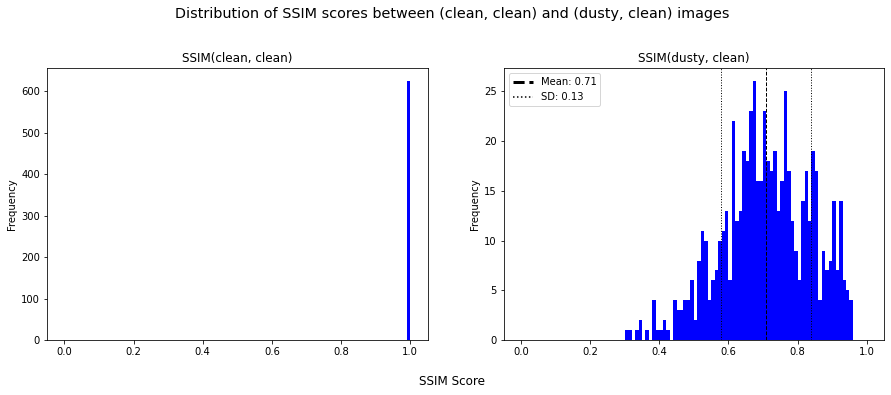

In [ ]:
plot_ssim(ssim_data, 1, 2, 'Distribution of SSIM scores between (clean, clean) and (dusty, clean) images', 'SSIM Score', 'Frequency', ['blue', 'blue'])

In [ ]:
def validate_ssim(model, metric, data, average=False):
    cb_handler = CallbackHandler(model.callbacks + [], None)
    metric = fastai.basic_train.validate(
        model.model, 
        data.valid_dl, 
        metric,
        cb_handler,
        average=average)
    ssims = torch.stack(metric).tolist()
    return pd.DataFrame(ssims, columns=['SSIM(pred, clean)','SSIM(pred, clean) channel 1', 'SSIM(pred, clean) channel 2', 'SSIM(pred, clean) channel 3'])

In [ ]:
generator_test = unet_learner(data_gen_test, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path).load('gen-pre-256-unfrozen-'+experiment_id).to_fp16()

In [ ]:
ssim_dusty_clean = validate_ssim(generator_test, SSIM_metric_eval(per_channel=True), data_gen_test)

In [ ]:
preds = generator_test.get_preds()

In [ ]:
def _show_results_eval(self, ds_type=DatasetType.Valid, rows:int=1, indexes=[], **kwargs):
        "Show `rows` result of predictions on `ds_type` dataset."
        #TODO: get read of has_arg x and split_kwargs_by_func if possible
        #TODO: simplify this and refactor with pred_batch(...reconstruct=True)
        n_items = rows ** 2 if self.data.train_ds.x._square_show_res else rows
        if indexes != []:
            for batch_index, batch_data in enumerate(self.dl(ds_type)):
                if batch_index in indexes: 
                    ds = self.dl(ds_type).dataset
                    self.callbacks.append(RecordOnCPU())
                    preds = self.pred_batch(ds_type, batch=batch_data)
                    *self.callbacks,rec_cpu = self.callbacks
                    x,y = rec_cpu.input,rec_cpu.target
                    norm = getattr(self.data,'norm',False)
                    if norm:
                        x = self.data.denorm(x)
                        if norm.keywords.get('do_y',False):
                            y     = self.data.denorm(y, do_x=True)
                            preds = self.data.denorm(preds, do_x=True)
                    analyze_kwargs,kwargs = split_kwargs_by_func(kwargs, ds.y.analyze_pred)
                    preds = [ds.y.analyze_pred(grab_idx(preds, i), **analyze_kwargs) for i in range(n_items)]
                    xs = [ds.x.reconstruct(grab_idx(x, i)) for i in range(n_items)]
                    if has_arg(ds.y.reconstruct, 'x'):
                        ys = [ds.y.reconstruct(grab_idx(y, i), x=x) for i,x in enumerate(xs)]
                        zs = [ds.y.reconstruct(z, x=x) for z,x in zip(preds,xs)]
                    else :
                        ys = [ds.y.reconstruct(grab_idx(y, i)) for i in range(n_items)]
                        zs = [ds.y.reconstruct(z) for z in preds]
                    show_xyzdiffs(ds.x, xs, ys, zs, **kwargs)

In [ ]:
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
0,0.873079,0.816433,0.902091,0.900713
1,0.905798,0.904626,0.914193,0.898574
2,0.881985,0.842942,0.913697,0.889314
3,0.873732,0.848472,0.914132,0.858592
4,0.945935,0.937651,0.952327,0.947826
...,...,...,...,...
619,0.822121,0.742937,0.819768,0.903659
620,0.831256,0.829566,0.874672,0.789531
621,0.843658,0.865142,0.856558,0.809274
622,0.839346,0.883888,0.802331,0.831818


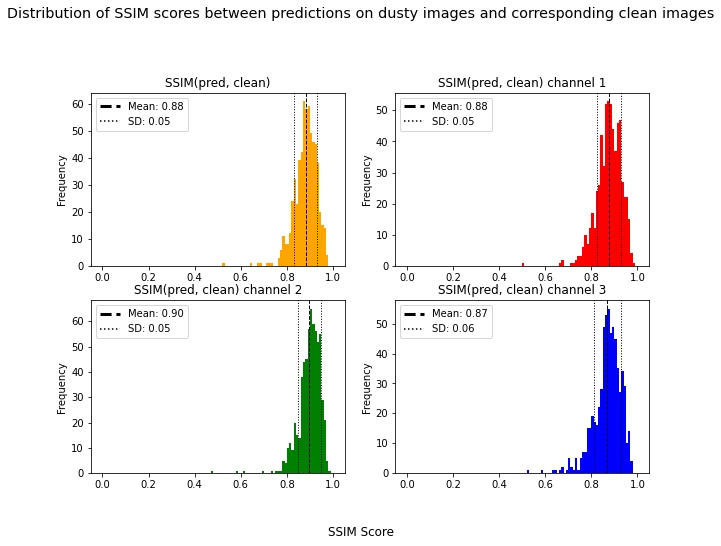

In [ ]:
plot_ssim(ssim_dusty_clean, 2, 2, 'Distribution of SSIM scores between predictions on dusty images and corresponding clean images', 'SSIM Score', 'Frequency', ['orange', 'red', 'green', 'blue'], (10,7))

In [ ]:
ssim_dusty_clean = ssim_dusty_clean.join(ssim_data['SSIM(dusty, clean)'])
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)"
0,0.873079,0.816433,0.902091,0.900713,0.662242
1,0.905798,0.904626,0.914193,0.898574,0.758344
2,0.881985,0.842942,0.913697,0.889314,0.675155
3,0.873732,0.848472,0.914132,0.858592,0.520921
4,0.945935,0.937651,0.952327,0.947826,0.828438
...,...,...,...,...,...
619,0.822121,0.742937,0.819768,0.903659,0.626210
620,0.831256,0.829566,0.874672,0.789531,0.686578
621,0.843658,0.865142,0.856558,0.809274,0.713903
622,0.839346,0.883888,0.802331,0.831818,0.700374


In [ ]:
ssim_dusty_clean['Δ(SSIM(pred, clean), SSIM(dusty, clean))'] = ssim_dusty_clean['SSIM(pred, clean)'] - ssim_dusty_clean['SSIM(dusty, clean)']
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
0,0.873079,0.816433,0.902091,0.900713,0.662242,0.210837
1,0.905798,0.904626,0.914193,0.898574,0.758344,0.147454
2,0.881985,0.842942,0.913697,0.889314,0.675155,0.206830
3,0.873732,0.848472,0.914132,0.858592,0.520921,0.352811
4,0.945935,0.937651,0.952327,0.947826,0.828438,0.117497
...,...,...,...,...,...,...
619,0.822121,0.742937,0.819768,0.903659,0.626210,0.195911
620,0.831256,0.829566,0.874672,0.789531,0.686578,0.144678
621,0.843658,0.865142,0.856558,0.809274,0.713903,0.129755
622,0.839346,0.883888,0.802331,0.831818,0.700374,0.138971


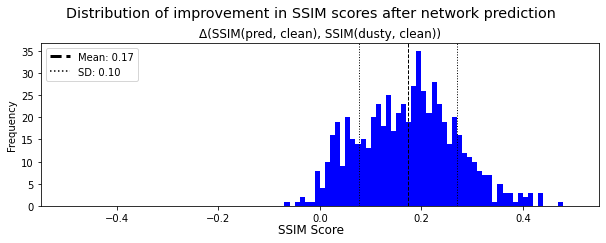

In [ ]:
plot_delta(ssim_dusty_clean[['Δ(SSIM(pred, clean), SSIM(dusty, clean))']], 1, 1, 'Distribution of improvement in SSIM scores after network prediction', 'SSIM Score', 'Frequency', ['blue'], figsize=(10,3))



*   Get top 3 items with biggest improvement - i.e. biggest delta.
*   Get top 3 items with smallest improvement.



In [ ]:
ssim_dusty_clean.nlargest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
331,0.788795,0.792241,0.821672,0.752473,0.310437,0.478359
599,0.785504,0.801015,0.797872,0.757625,0.348291,0.437212
177,0.817810,0.820492,0.839247,0.793692,0.386024,0.431786


In [ ]:
indexes = ssim_dusty_clean.nlargest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))']).index.to_list()

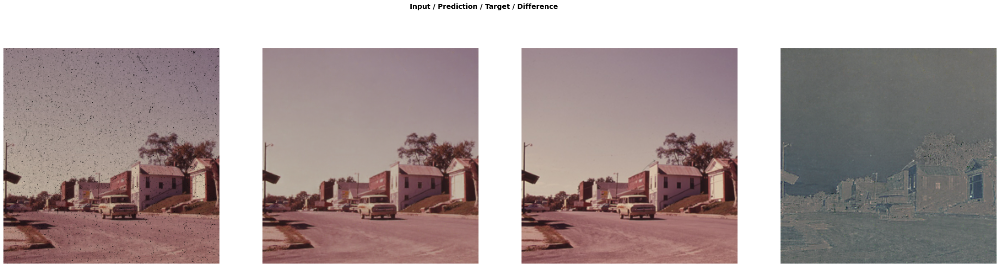

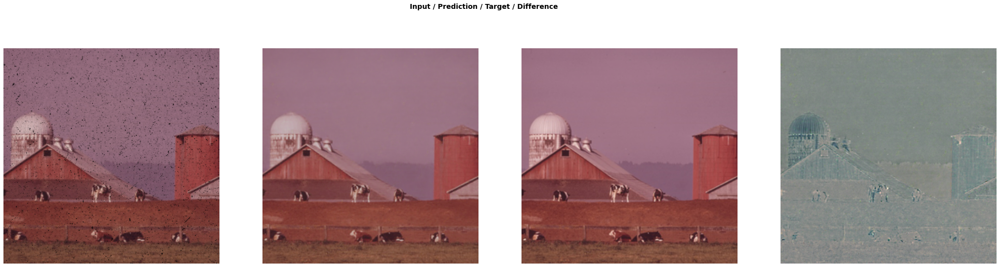

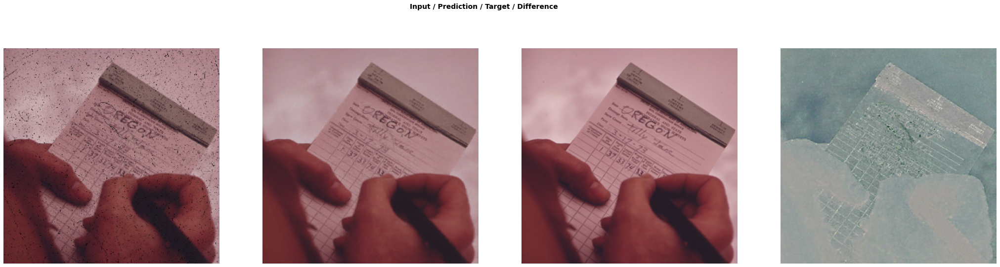

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=9)

In [ ]:
ssim_dusty_clean.nsmallest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
390,0.841103,0.798543,0.838481,0.886284,0.902110,-0.061007
445,0.853268,0.911138,0.902314,0.746351,0.900224,-0.046956
429,0.816876,0.771908,0.814755,0.863966,0.849116,-0.032239


In [ ]:
indexes = ssim_dusty_clean.nsmallest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))']).index.to_list()
indexes

[390, 445, 429]

Look at the prediction for these items.

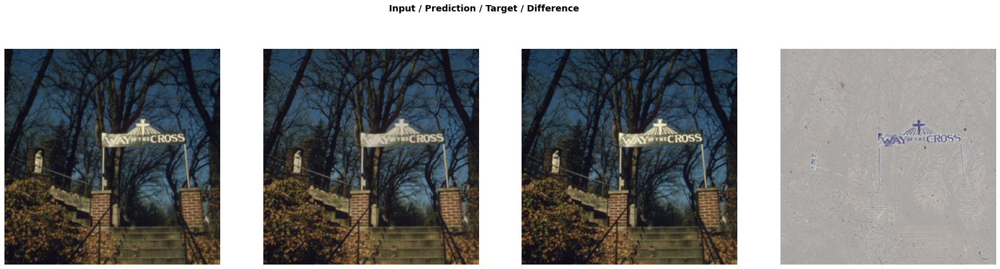

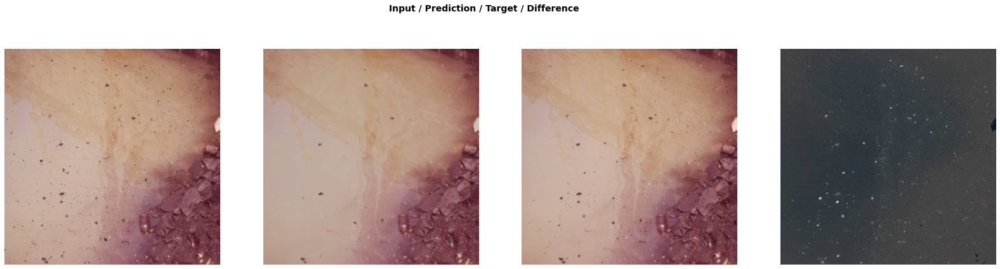

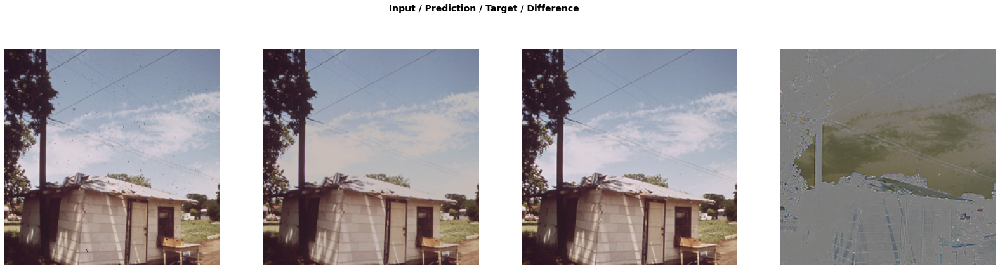

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)

Now check wat happens to already clean images.

In [ ]:
generator_test = unet_learner(data_gen_test_clean, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path).load('gen-pre-256-unfrozen-'+experiment_id).to_fp16()

In [ ]:
ssim_clean_clean = validate_ssim(generator_test, SSIM_metric_eval(per_channel=True), data_gen_test_clean)

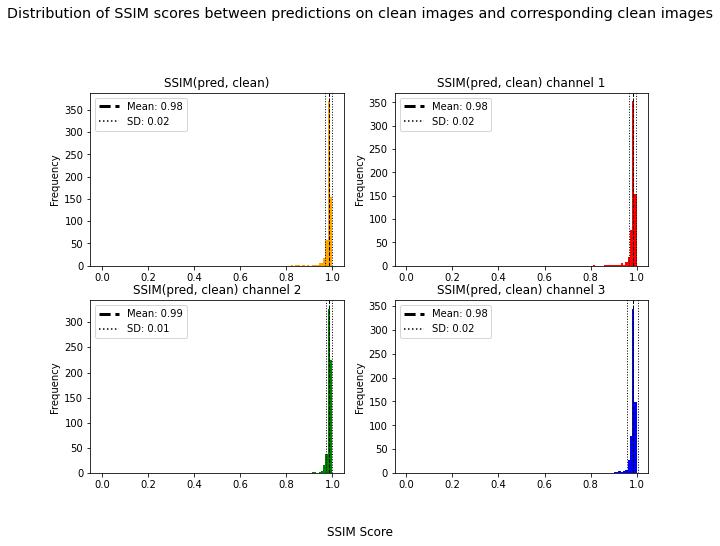

In [ ]:
plot_ssim(ssim_clean_clean, 2, 2, 'Distribution of SSIM scores between predictions on clean images and corresponding clean images', 'SSIM Score', 'Frequency', ['orange', 'red', 'green', 'blue'], (10,7))

In [ ]:
ssim_clean_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
0,0.983536,0.977574,0.988062,0.984971
1,0.988761,0.987542,0.989421,0.989321
2,0.987093,0.987050,0.986981,0.987249
3,0.990037,0.991627,0.991312,0.987172
4,0.987197,0.987215,0.988155,0.986220
...,...,...,...,...
619,0.987421,0.984697,0.988041,0.989525
620,0.945436,0.962551,0.966464,0.907293
621,0.982216,0.983958,0.977723,0.984966
622,0.932377,0.922189,0.952653,0.922290


These clean images were damaged the most.

In [ ]:
ssim_clean_clean.nsmallest(3, columns=['SSIM(pred, clean)'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
227,0.820396,0.955059,0.923766,0.582362
213,0.843694,0.812329,0.897958,0.820797
334,0.855435,0.888683,0.785337,0.892287


In [ ]:
indexes = ssim_clean_clean.nsmallest(3, columns=['SSIM(pred, clean)']).index.to_list()

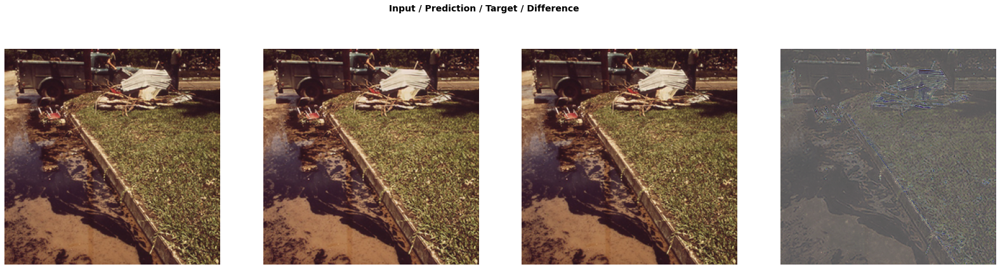

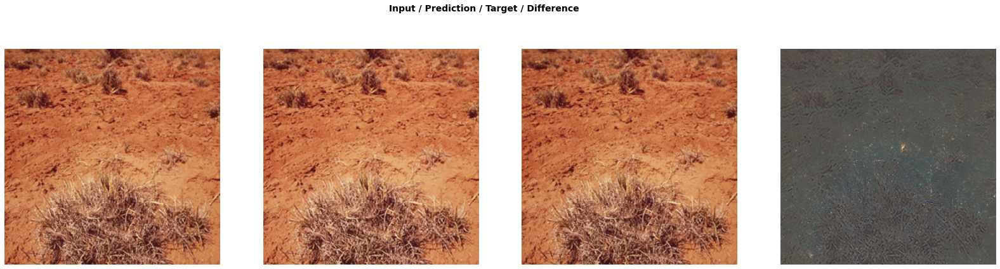

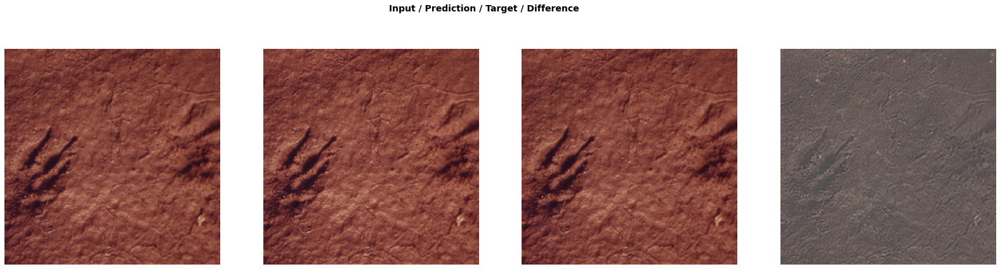

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)

And these were damaged the least.

In [ ]:
ssim_clean_clean.nlargest(3, columns=['SSIM(pred, clean)'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
450,0.995547,0.995387,0.995502,0.995752
527,0.995482,0.995078,0.996251,0.995117
407,0.994823,0.994334,0.995412,0.994722


In [ ]:
indexes = ssim_clean_clean.nlargest(3, columns=['SSIM(pred, clean)']).index.to_list()

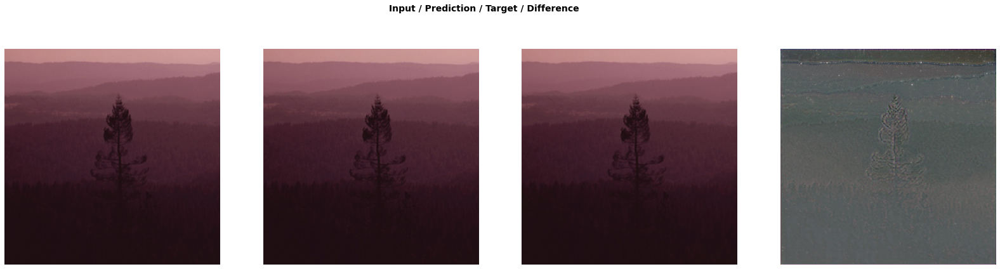

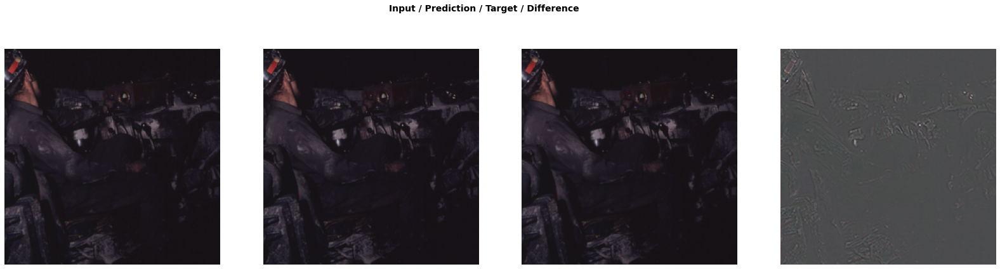

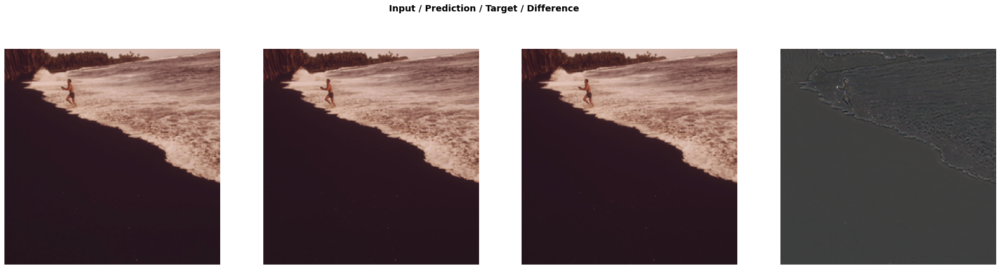

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)